# **NutriScore**

NutriScore adalah aplikasi web yang menghasilkan skor nutrisi dari makanan berdasarkan foto yang diunggah pengguna. Dengan mempertimbangkan usia, jenis kelamin, tinggi badan, berat badan, dan aktivitas, aplikasi ini memberikan penilaian seberapa sehat suatu makanan bagi masing-masing individu. Skor nutrisi ini membantu pengguna, terutama yang sedang diet atau menjaga pola makan, dalam menentukan apakah makanan tersebut sesuai dengan kebutuhan gizi mereka.


# **Import Library**


Pada tahap ini, kita memuat sejumlah pustaka Python yang dibutuhkan untuk mendukung seluruh proses analisis data dan pembangunan model machine learning. Masing-masing pustaka memiliki peran dan kegunaannya sendiri.

In [1]:
!pip install tensorflow

In [2]:
!pip install tensorflowjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 5.0 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-cloud-bigquery 3.33.0 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.
db-dtypes 1.4.3 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.


In [3]:
import os
import shutil
import zipfile
import numpy as np
import pandas as pd
from tqdm import tqdm
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tqdm.notebook import tqdm as tq
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

#**Loading Dataset**

Agar dapat mengambil dataset dari Kaggle melalui Google Colab, perlu dilakukan pengaturan kredensial API Kaggle terlebih dahulu. Kaggle menyediakan API yang memungkinkan pengguna mengakses dataset secara langsung tanpa harus mengunduhnya secara manual.

Langkah ini melibatkan pengunggahan file kaggle.json, yang berisi informasi kredensial API dan dapat diperoleh dari halaman akun pengguna di Kaggle.

In [4]:
# Import module yang disediakan google colab untuk kebutuhan upload file
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"saniskalita","key":"7866ef8cb9a7e995a8abaf1a0eede5c8"}'}

Perlu diketahui bahwa dataset yang kami gunakan tidak sepenuhnya berasal dari satu sumber di Kaggle. Dataset ini kami buat sendiri berdasarkan hasil pengumpulan dari beberapa sumber open source yang tersedia di Kaggle. Setelah dikumpulkan, kami melakukan sejumlah penyesuaian dan pembersihan data agar sesuai dengan kebutuhan proyek. Dataset hasil kurasi dan modifikasi ini kemudian kami unggah kembali ke platform Kaggle.

In [5]:
# Menghapus folder "NutriScore Dataset" jika sudah ada sebelumnya
!rm -rf "NutriScore Dataset"

# Menyiapkan folder .kaggle untuk menyimpan kredensial API Kaggle
!mkdir -p ~/.kaggle

# Menyalin file kaggle.json yang berisi API key ke dalam folder yang tepat
!cp kaggle.json ~/.kaggle/

# Memberikan hak akses agar file kaggle.json dapat dibaca oleh API Kaggle
!chmod 600 ~/.kaggle/kaggle.json

# Mengunduh dataset "NutriScore Dataset" dari Kaggle
!kaggle datasets download -d feniakarenina/nutriscore-dataset

# Mengekstrak file zip yang berisi dataset setelah diunduh
!unzip nutriscore-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: Pepes Ikan/00000131.jpg  
  inflating: Pepes Ikan/00000132.jpg  
  inflating: Pepes Ikan/00000133.jpg  
  inflating: Pepes Ikan/00000134.jpg  
  inflating: Pepes Ikan/00000135.jpg  
  inflating: Pepes Ikan/00000136.jpg  
  inflating: Pepes Ikan/00000137.jpg  
  inflating: Pepes Ikan/00000138.jpg  
  inflating: Pepes Ikan/00000139.jpg  
  inflating: Pepes Ikan/00000140.jpg  
  inflating: Pepes Ikan/00000141.jpg  
  inflating: Pepes Ikan/00000144.jpg  
  inflating: Pepes Ikan/00000145.jpg  
  inflating: Pepes Ikan/00000146.jpg  
  inflating: Pepes Ikan/00000147.jpg  
  inflating: Pepes Ikan/00000148.jpg  
  inflating: Pepes Ikan/00000149.jpg  
  inflating: Pepes Ikan/00000150.jpg  
  inflating: Pepes Ikan/00000151.jpg  
  inflating: Pepes Ikan/00000152.jpg  
  inflating: Pepes Ikan/00000153.jpg  
  inflating: Pepes Ikan/00000154.jpg  
  inflating: Pepes Ikan/00000155.jpg  
  inflating: Pepes Ikan/00000156.jpg  
  inflating: 

# **Mengorganisir Dataset ke dalam Struktur Folder Proyek**

Sebelum memulai proses pelatihan model, kita perlu memastikan bahwa struktur folder dataset tersusun dengan rapi dan terstandarisasi. Hal ini penting untuk mempermudah proses pemuatan data menggunakan generator atau loader seperti ImageDataGenerator dari TensorFlow/Keras.

In [6]:
!mkdir -p NutriScoreDataset

# Pindahkan semua folder makanan ke dalam NutriScoreDataset
!mv "Ayam Crispy" "Ayam Kecap" "Ayam Serundeng" "Bakso" "Bubur Ayam" "Capcay" \
"Cumi Bakar" "Cumi Hitam" "Cumi Rica" "Gado-Gado" \
"Garang Asem" "Gudeg" "Ikan Bakar" "Ikan Goreng" "Kentang Balado" "Mie Goreng" \
"Nasi Bakar" "Nasi Goreng" "Nasi Kuning" "Nasi Merah" "Nasi Rames" "Opor Ayam" \
"Pecel" "Pepes Ikan" "Perkedel Kentang" "Rawon" "Rendang" "Salad Sayur" \
"Sayur Asem" "Sayur Sop" "Sate Ayam" "Sate Kambing" "Soto Ayam" "Telur Balado" \
"Telur Dadar" "Tumis Kacang Panjang Tahu" "Tumis Kangkung" "Tumis Terong" \
"Udang Asam Manis" "Udang Goreng Tepung" NutriScoreDataset/

## **Plot Gambar Sample di Setiap Kelas**

Selanjutnya, kami melakukan plot gambar sample di setiap kelas. Visualisasi ini membantu untuk memastikan keberagaman dan kualitas gambar di setiap kelas sebelum melanjutkan ke tahap pelatihan model. Hal ini penting agar model dapat belajar dari data yang representatif dan seimbang.


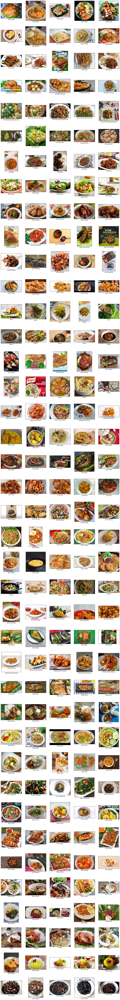

In [7]:
# Membuat kamus yang menyimpan gambar untuk setiap kelas dalam data
food_images = {}

# Tentukan path sumber dataset
data_dir = "NutriScoreDataset"

# Menyimpan gambar di setiap kelas dalam kamus
for category in os.listdir(data_dir):
    category_path = os.path.join(data_dir, category)
    if os.path.isdir(category_path):
        food_images[category] = os.listdir(category_path)

# Menentukan jumlah gambar yang ingin ditampilkan di bawah setiap kelas
num_images = 5

# Menentukan ukuran plot berdasarkan jumlah kelas
fig, axs = plt.subplots(len(food_images.keys()), num_images, figsize=(15, len(food_images.keys()) * 3))

# Loop untuk menampilkan gambar
for i, (class_name, images) in enumerate(food_images.items()):
    selected_images = np.random.choice(images, num_images, replace=False)

    for j, image_name in enumerate(selected_images):
        img_path = os.path.join(data_dir, class_name, image_name)
        img = Image.open(img_path).convert("RGB")  # Menggunakan RGB untuk gambar berwarna
        axs[i, j].imshow(img)
        axs[i, j].set(xlabel=class_name, xticks=[], yticks=[])

# Menyesuaikan layout agar lebih rapi
fig.tight_layout(pad=3.0)

# Menampilkan gambar
plt.show()

## **Plot Distribusi Gambar setiap Kelas**

Selanjutnya, dilakukan pemeriksaan distribusi jumlah gambar di setiap kelas dalam dataset. Tujuannya adalah untuk mengetahui apakah ada ketidakseimbangan jumlah data antar kelas yang bisa mempengaruhi performa model saat pelatihan.

In [8]:
# Path ke folder dataset gambar makanan
food_path = "NutriScoreDataset"

# Inisialisasi list untuk menyimpan informasi
file_name = []
labels = []
full_path = []

# Menelusuri seluruh direktori untuk mendapatkan path dan label gambar
for root, dirs, files in os.walk(food_path):
    for name in files:
        # Filter hanya file gambar
        if name.lower().endswith(('.png', '.jpg', '.jpeg')):
            path_file = os.path.join(root, name)
            full_path.append(path_file)
            file_name.append(name)
            labels.append(os.path.basename(root))  # Label diambil dari nama folder terakhir

# Memasukkan data ke dalam DataFrame
df = pd.DataFrame({
    "path": full_path,
    "file_name": file_name,
    "labels": labels
})

# Menampilkan jumlah gambar untuk setiap label
print("Jumlah gambar per label:")
print(df['labels'].value_counts())

Jumlah gambar per label:
labels
Nasi Goreng                  300
Sate Ayam                    300
Perkedel Kentang             300
Tumis Kacang Panjang Tahu    300
Rendang                      300
Garang Asem                  300
Salad Sayur                  300
Ayam Kecap                   300
Sayur Asem                   300
Ayam Serundeng               300
Sate Kambing                 300
Ayam Crispy                  300
Pecel                        300
Rawon                        300
Ikan Goreng                  300
Bakso                        300
Udang Asam Manis             300
Opor Ayam                    300
Ikan Bakar                   300
Cumi Rica                    300
Tumis Terong                 300
Telur Dadar                  300
Capcay                       300
Kentang Balado               300
Nasi Merah                   300
Nasi Bakar                   300
Udang Goreng Tepung          300
Pepes Ikan                   300
Nasi Rames                   300
Soto Ayam  

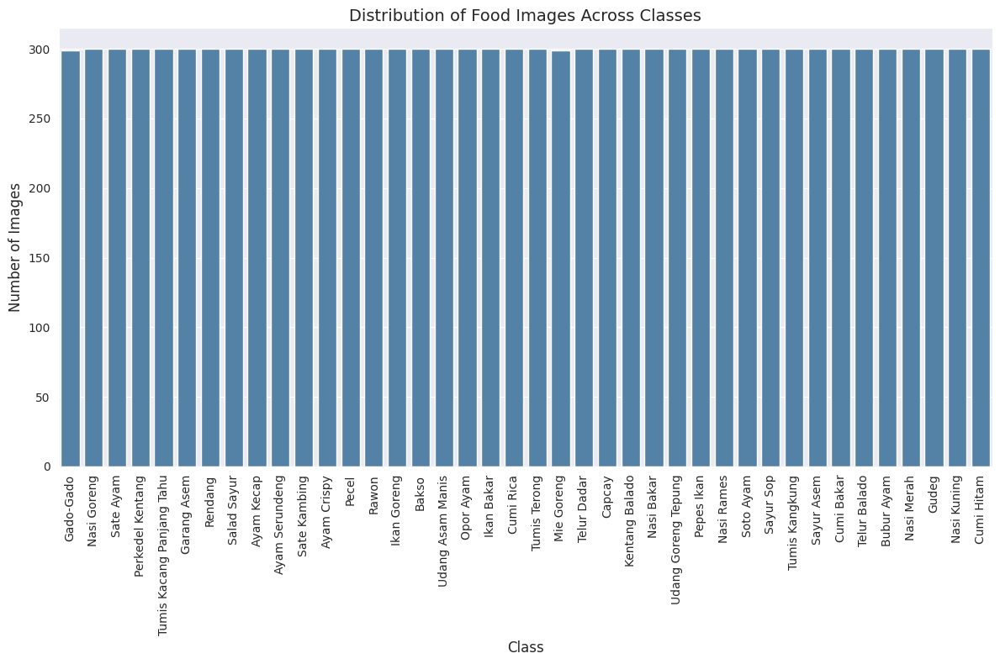

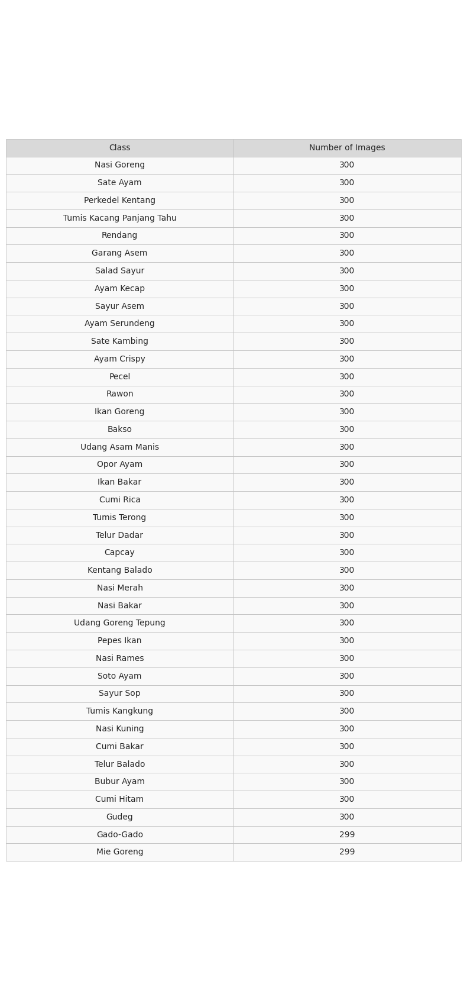

In [9]:
# Plot distribusi jumlah gambar per kelas
plt.figure(figsize=(12, 8))  # Ukuran lebih besar agar tidak padat
sns.set_style("darkgrid")
# Changed 'label' to 'labels' to match the column name in the dataframe
plot_data = sns.countplot(x='labels', data=df, color="steelblue")  # Menggunakan warna tunggal yang profesional

# Memberi judul dan label
plt.title('Distribution of Food Images Across Classes', fontsize=14)
plt.xlabel('Class', fontsize=12)
plt.ylabel('Number of Images', fontsize=12)
plt.xticks(rotation=90, fontsize=10)  # Rotasi 90 derajat untuk menghindari tumpang tindih
plt.tight_layout()

# Membuat tabel untuk jumlah gambar per kelas
counts = df['labels'].value_counts().reset_index() # Changed 'label' to 'labels'
counts.columns = ['Class', 'Number of Images']

# Plot table jumlah gambar per kelas
plt.figure(figsize=(8, len(counts) * 0.4 + 1))  # Menyesuaikan tinggi tabel
plt.axis('off')
table = plt.table(cellText=counts.values,
                  colLabels=counts.columns,
                  loc='center',
                  cellLoc='center',
                  colLoc='center',
                  cellColours=[['#f9f9f9', '#f9f9f9']] * len(counts),  # Warna latar sel
                  colColours=['#d9d9d9', '#d9d9d9'])  # Warna header
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.4)
for (row, col), cell in table.get_celld().items():
    cell.set_edgecolor('#bbbbbb')
    cell.set_linewidth(0.5)

# Menampilkan semua visualisasi
plt.tight_layout()
plt.show()

Hasil pemeriksaan menunjukkan bahwa setiap kelas memiliki 300 gambar, sehingga dataset ini seimbang (balanced). Kondisi ini sangat ideal untuk pelatihan model karena menghindari bias akibat ketimpangan data antar kelas.

# **Data Preprocessing**

## **Kompresi dan Penyesuaian Ukuran Gambar dengan Padding**

Sebelum gambar-gambar dalam dataset digunakan untuk melatih model Convolutional Neural Network (CNN), sangat penting untuk memastikan bahwa seluruh gambar memiliki dimensi yang seragam. Pada proyek ini, kami menetapkan ukuran standar 224x224 piksel, yang merupakan resolusi umum untuk arsitektur CNN seperti MobileNet.

In [10]:
def compress_images(input_dir, output_dir, target_size=(224, 224), quality=70, padding_color=(255, 255, 255)):
    """
    Kompres dan resize gambar dalam folder input ke ukuran target_size dengan padding
    untuk menjaga aspect ratio. Hasil disimpan di folder output dengan format JPEG.

    Args:
        input_dir (str): Folder utama berisi subfolder gambar.
        output_dir (str): Folder tujuan hasil kompresi.
        target_size (tuple): Ukuran gambar output, misal (224, 224).
        quality (int): Kualitas JPEG (0-100).
        padding_color (tuple): Warna padding, default putih (255,255,255).
    """
    os.makedirs(output_dir, exist_ok=True)

    folders = [f for f in os.listdir(input_dir) if os.path.isdir(os.path.join(input_dir, f))]

    for folder in folders:
        folder_path = os.path.join(input_dir, folder)
        save_path = os.path.join(output_dir, folder)
        os.makedirs(save_path, exist_ok=True)

        print(f"Memproses folder: {folder}")

        files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

        for file in tqdm(files, desc=f"Memproses {folder}", unit="file"):
            input_path = os.path.join(folder_path, file)
            filename_wo_ext = os.path.splitext(file)[0]
            output_path = os.path.join(save_path, f"{filename_wo_ext}.jpg")

            try:
                with Image.open(input_path) as img:
                    # Konversi mode agar aman simpan ke JPEG
                    if img.mode in ("RGBA", "P"):
                        img = img.convert("RGB")

                    # Resize dengan aspect ratio dan padding
                    img = ImageOps.fit(img, target_size, method=Image.Resampling.LANCZOS, centering=(0.5, 0.5))

                    # Simpan dengan kompresi JPEG
                    img.save(output_path, format="JPEG", quality=quality, optimize=True)

            except Exception as e:
                print(f"Gagal proses {file}: {e}")

if __name__ == "__main__":
    # Contoh pemakaian:
    compress_images(
        input_dir="NutriScoreDataset",
        output_dir="Nutri Score/dataset",
        target_size=(224, 224),
        quality=70,
        padding_color=(255, 255, 255)
    )

Memproses folder: Gado-Gado


Memproses Gado-Gado: 100%|██████████| 299/299 [00:07<00:00, 41.13file/s]


Memproses folder: Nasi Goreng


Memproses Nasi Goreng:  81%|████████  | 242/300 [00:04<00:01, 50.75file/s]/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
Memproses Nasi Goreng: 100%|██████████| 300/300 [00:05<00:00, 53.33file/s]


Memproses folder: Sate Ayam


Memproses Sate Ayam: 100%|██████████| 300/300 [00:03<00:00, 78.38file/s]


Memproses folder: Perkedel Kentang


Memproses Perkedel Kentang: 100%|██████████| 300/300 [00:03<00:00, 84.13file/s]


Memproses folder: Tumis Kacang Panjang Tahu


Memproses Tumis Kacang Panjang Tahu: 100%|██████████| 300/300 [00:03<00:00, 91.64file/s]


Memproses folder: Garang Asem


Memproses Garang Asem: 100%|██████████| 300/300 [00:04<00:00, 63.82file/s]


Memproses folder: Rendang


Memproses Rendang: 100%|██████████| 300/300 [00:05<00:00, 59.67file/s]


Memproses folder: Salad Sayur


Memproses Salad Sayur: 100%|██████████| 300/300 [00:04<00:00, 68.86file/s]


Memproses folder: Ayam Kecap


Memproses Ayam Kecap: 100%|██████████| 300/300 [00:04<00:00, 61.76file/s]


Memproses folder: Ayam Serundeng


Memproses Ayam Serundeng: 100%|██████████| 300/300 [00:04<00:00, 73.81file/s]


Memproses folder: Sate Kambing


Memproses Sate Kambing: 100%|██████████| 300/300 [00:06<00:00, 45.16file/s]


Memproses folder: Ayam Crispy


Memproses Ayam Crispy: 100%|██████████| 300/300 [00:04<00:00, 60.70file/s]


Memproses folder: Pecel


Memproses Pecel: 100%|██████████| 300/300 [00:03<00:00, 78.01file/s]


Memproses folder: Rawon


Memproses Rawon: 100%|██████████| 300/300 [00:04<00:00, 62.14file/s]


Memproses folder: Ikan Goreng


Memproses Ikan Goreng: 100%|██████████| 300/300 [00:04<00:00, 67.87file/s]


Memproses folder: Bakso


Memproses Bakso: 100%|██████████| 300/300 [00:06<00:00, 49.30file/s]


Memproses folder: Udang Asam Manis


Memproses Udang Asam Manis: 100%|██████████| 300/300 [00:03<00:00, 76.52file/s]


Memproses folder: Opor Ayam


Memproses Opor Ayam: 100%|██████████| 300/300 [00:03<00:00, 84.91file/s]


Memproses folder: Ikan Bakar


Memproses Ikan Bakar: 100%|██████████| 300/300 [00:06<00:00, 46.85file/s]


Memproses folder: Cumi Rica


Memproses Cumi Rica: 100%|██████████| 300/300 [00:03<00:00, 80.10file/s]


Memproses folder: Tumis Terong


Memproses Tumis Terong: 100%|██████████| 300/300 [00:03<00:00, 79.04file/s]


Memproses folder: Mie Goreng


Memproses Mie Goreng: 100%|██████████| 299/299 [00:05<00:00, 55.36file/s]


Memproses folder: Telur Dadar


Memproses Telur Dadar: 100%|██████████| 300/300 [00:03<00:00, 81.11file/s]


Memproses folder: Capcay


Memproses Capcay: 100%|██████████| 300/300 [00:05<00:00, 52.98file/s]


Memproses folder: Kentang Balado


Memproses Kentang Balado: 100%|██████████| 300/300 [00:03<00:00, 89.15file/s] 


Memproses folder: Nasi Bakar


Memproses Nasi Bakar: 100%|██████████| 300/300 [00:04<00:00, 67.90file/s]


Memproses folder: Udang Goreng Tepung


Memproses Udang Goreng Tepung: 100%|██████████| 300/300 [00:05<00:00, 59.28file/s]


Memproses folder: Pepes Ikan


Memproses Pepes Ikan: 100%|██████████| 300/300 [00:03<00:00, 76.06file/s]


Memproses folder: Nasi Rames


Memproses Nasi Rames: 100%|██████████| 300/300 [00:04<00:00, 65.03file/s]


Memproses folder: Soto Ayam


Memproses Soto Ayam: 100%|██████████| 300/300 [00:05<00:00, 57.58file/s]


Memproses folder: Sayur Sop


Memproses Sayur Sop: 100%|██████████| 300/300 [00:04<00:00, 67.31file/s]


Memproses folder: Tumis Kangkung


Memproses Tumis Kangkung: 100%|██████████| 300/300 [00:03<00:00, 77.11file/s]


Memproses folder: Sayur Asem


Memproses Sayur Asem: 100%|██████████| 300/300 [00:05<00:00, 58.09file/s]


Memproses folder: Cumi Bakar


Memproses Cumi Bakar: 100%|██████████| 300/300 [00:03<00:00, 77.61file/s]


Memproses folder: Telur Balado


Memproses Telur Balado: 100%|██████████| 300/300 [00:05<00:00, 55.68file/s]


Memproses folder: Bubur Ayam


Memproses Bubur Ayam: 100%|██████████| 300/300 [00:04<00:00, 70.23file/s]


Memproses folder: Nasi Merah


Memproses Nasi Merah: 100%|██████████| 300/300 [00:05<00:00, 58.52file/s]


Memproses folder: Gudeg


Memproses Gudeg: 100%|██████████| 300/300 [00:03<00:00, 75.01file/s] 


Memproses folder: Nasi Kuning


Memproses Nasi Kuning: 100%|██████████| 300/300 [00:06<00:00, 49.46file/s]


Memproses folder: Cumi Hitam


Memproses Cumi Hitam: 100%|██████████| 300/300 [00:05<00:00, 56.13file/s]


## **Split Dataset**

Data dibagi menjadi tiga bagian utama untuk proses pelatihan dan evaluasi model: data pelatihan (train), validasi (validation), dan pengujian (test). Pertama, dataset dibagi dengan rasio 80% untuk training dan 20% untuk testing. Selanjutnya, data training ini dipisah lagi menjadi 80% untuk training dan 20% untuk validasi agar model dapat di-tuning dan dioptimalkan secara lebih efektif. Pembagian ini memastikan model dapat belajar, divalidasi performanya, dan diuji secara objektif.

In [11]:
# Variabel yang digunakan pada pemisahan data ini dimana variabel X = data path dan Y = data labels
X = df['path']
y = df['labels']

# Split dataset awal menjadi data train (80%) dan test (20%)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=300)

# Split data train lebih lanjut menjadi train (80%) dan validation (20%) dari data train awal
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=300)

# Cek jumlah data train, validation, dan test
print(f'Train size: {len(X_train)}')
print(f'Validation size: {len(X_val)}')
print(f'Test size: {len(X_test)}')

Train size: 7678
Validation size: 1920
Test size: 2400


Berikut adalah distribusi data per kelas di masing-masing subset (train, validation, test).

In [12]:
# Menyatukan data train, validation, dan test ke dalam dataframe masing-masing
df_tr = pd.DataFrame({'path': X_train, 'labels': y_train, 'set': 'train'})
df_val = pd.DataFrame({'path': X_val, 'labels': y_val, 'set': 'validation'})
df_te = pd.DataFrame({'path': X_test, 'labels': y_test, 'set': 'test'})

# Gabungkan DataFrame train, validation, dan test ke dalam satu DataFrame
df_all = pd.concat([df_tr, df_val, df_te], ignore_index=True)

# Tampilkan distribusi data dalam bentuk tabel
distribution = df_all.groupby(['set', 'labels']).size().unstack(fill_value=0)
display(distribution)

labels,Ayam Crispy,Ayam Kecap,Ayam Serundeng,Bakso,Bubur Ayam,Capcay,Cumi Bakar,Cumi Hitam,Cumi Rica,Gado-Gado,...,Sayur Asem,Sayur Sop,Soto Ayam,Telur Balado,Telur Dadar,Tumis Kacang Panjang Tahu,Tumis Kangkung,Tumis Terong,Udang Asam Manis,Udang Goreng Tepung
set,,,,,,,,,,,,,,,,,,,,,
test,49,63,65,63,52,65,65,62,62,69,...,63,68,63,54,66,59,42,64,69,56
train,198,192,196,195,188,185,198,188,184,180,...,189,196,190,197,184,193,211,186,193,196
validation,53,45,39,42,60,50,37,50,54,50,...,48,36,47,49,50,48,47,50,38,48


## **Image Data Generator**

Selanjutnya, langkah yang dilakukan adalah mengorganisir dataset dengan menyalin setiap file gambar ke folder baru yang terstruktur berdasarkan kategori data (train, validation, dan test) serta label kelasnya. Hal ini bertujuan agar dataset tersusun rapi dan mudah digunakan dalam proses pelatihan model.

In [13]:
# Tentukan folder untuk menampung data final
datasource_path = "Nutri Score/dataset"
dataset_path = "Dataset-Final/"

# Membuat folder untuk training dan testing
for index, row in tq(df_all.iterrows()):
    file_path = row['path']
    if os.path.exists(file_path) == False:
        file_path = os.path.join(datasource_path, row['labels'], row['file_name'].split('.')[0])

    # Buat direktori tujuan folder untuk masing-masing data set
    if os.path.exists(os.path.join(dataset_path, row['set'], row['labels'])) == False:
        os.makedirs(os.path.join(dataset_path, row['set'], row['labels']))

    # Tentukan tujuan file
    destination_file_name = file_path.split('/')[-1]
    file_dest = os.path.join(dataset_path, row['set'], row['labels'], destination_file_name)

    # Salin file dari sumber ke tujuan
    if os.path.exists(file_dest) == False:
        shutil.copy2(file_path, file_dest)

0it [00:00, ?it/s]

## **Data Augmentation**

Selanjutnya, dilakukan tahap augmentasi data pada dataset training untuk memperkaya variasi gambar dan membantu model lebih tahan terhadap perubahan pada gambar asli. Sementara itu, data validation dan testing hanya dilakukan normalisasi (rescaling) agar model diuji dengan data yang konsisten dan tidak mengalami perubahan tambahan. Kemudian, generator dibuat untuk masing-masing dataset agar siap digunakan dalam proses pelatihan dan evaluasi model.

In [14]:
# Direktori untuk training, testing, dan validation
TRAIN_DIR = "Dataset-Final/train/"
VAL_DIR = "Dataset-Final/validation/"
TEST_DIR = "Dataset-Final/test/"

# Data Augmentation hanya untuk training set
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=25,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.2,
    zoom_range=0.3,
    horizontal_flip=True,
    brightness_range=[0.2, 1.5],
    fill_mode='nearest',
)

# Hanya rescaling untuk validation dan test set
val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# Generator untuk training
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    color_mode='rgb'
)

# Generator untuk validation
validation_generator = val_datagen.flow_from_directory(
    VAL_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False,
    color_mode='rgb'
)

# Generator untuk testing
test_generator = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False,
    color_mode='rgb'
)


Found 7678 images belonging to 40 classes.
Found 1920 images belonging to 40 classes.
Found 2400 images belonging to 40 classes.


# **Modelling**

Untuk pelatihan model, kami menggunakan arsitektur utama (base model) MobileNetV2 yang sudah dilatih sebelumnya (pretrained) sebagai ekstraktor fitur. Model ini dimodifikasi dengan menambahkan beberapa lapisan fully connected untuk menyesuaikan dengan 40 kelas makanan rumahan Indonesia yang ada pada dataset kami. Selain itu, beberapa lapisan atas dari MobileNetV2 kami buka (unfreeze) agar bisa ikut diperbarui selama pelatihan, sehingga model dapat menyesuaikan diri lebih baik dengan data spesifik proyek ini.

In [ ]:
num_classes = 40
input_shape = (224, 224, 3)

# Load pretrained MobileNetV2 tanpa top layer
base_model = MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')

# Unfreeze bagian atas dari base_model
for layer in base_model.layers[-20:]:
    layer.trainable = True

# Tambahkan layer klasifikasi di atas base_model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.2)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.3)(x)
output = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=output)

# Compile model
model.compile(
    optimizer=Adam(learning_rate=3e-5),  # lebih kecil supaya tidak over-update pretrained weight
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,596,200 (9.90 MB)

 Trainable params: 2,562,088 (9.77 MB)

 Non-trainable params: 34,112 (133.25 KB)

Untuk proses pelatihan, kami menggunakan callback ReduceLROnPlateau yang secara otomatis menurunkan learning rate ketika nilai validasi loss tidak membaik selama beberapa epoch. Hal ini membantu model keluar dari kondisi stagnasi sehingga performa dapat meningkat. Selain itu, kami juga menerapkan EarlyStopping untuk menghentikan pelatihan lebih awal jika model tidak menunjukkan perbaikan pada validasi loss selama beberapa epoch, sekaligus mengembalikan bobot terbaik agar hasil akhir lebih optimal. Pelatihan dilakukan selama maksimal 50 epoch dengan pemantauan terus menerus pada data validasi.

In [ ]:
lr_scheduler = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=3,
    min_lr=1e-6,
    verbose=1
)
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
    lr_scheduler
]

epochs = 50

history = model.fit(
    train_generator,
    epochs=epochs,
    validation_data=validation_generator,
    callbacks=callbacks
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 194s 597ms/step - accuracy: 0.0413 - loss: 3.8981 - val_accuracy: 0.1469 - val_loss: 3.2604 - learning_rate: 3.0000e-05
Epoch 2/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 116s 482ms/step - accuracy: 0.1486 - loss: 3.2587 - val_accuracy: 0.2792 - val_loss: 2.6109 - learning_rate: 3.0000e-05
Epoch 3/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 143s 487ms/step - accuracy: 0.3142 - loss: 2.5468 - val_accuracy: 0.4385 - val_loss: 2.0118 - learning_rate: 3.0000e-05
Epoch 4/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 116s 481ms/step - accuracy: 0.4278 - loss: 1.9979 - val_accuracy: 0.5328 - val_loss: 1.6501 - learning_rate: 3.0000e-05
Epoch 5/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 117s 486ms/step - accuracy: 0.5226 - loss: 1.6830 - val_accuracy: 0.6062 - val_loss: 1.3741 - learning_rate: 3.0000e-05
Epoch 6/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 115s 480ms/step - accuracy: 0.5701 - loss: 1.4692 - val_accuracy: 0.6479 - val_loss: 1.2052 - learning_rate: 3.0000e-05
Epoch 7/50
240/240 ━━━━━━━━━━━━━━━━━━━━ 

# **Evaluasi**

Selanjutnya kami akan melakukan evaluasi terhadap pelatihan yang telah dilakukan dengan memvisualisasikan grafik akurasi dan loss pada data training serta validasi. Grafik ini berguna untuk memantau performa model dan melihat apakah model mengalami overfitting, underfitting, atau sudah konvergen.

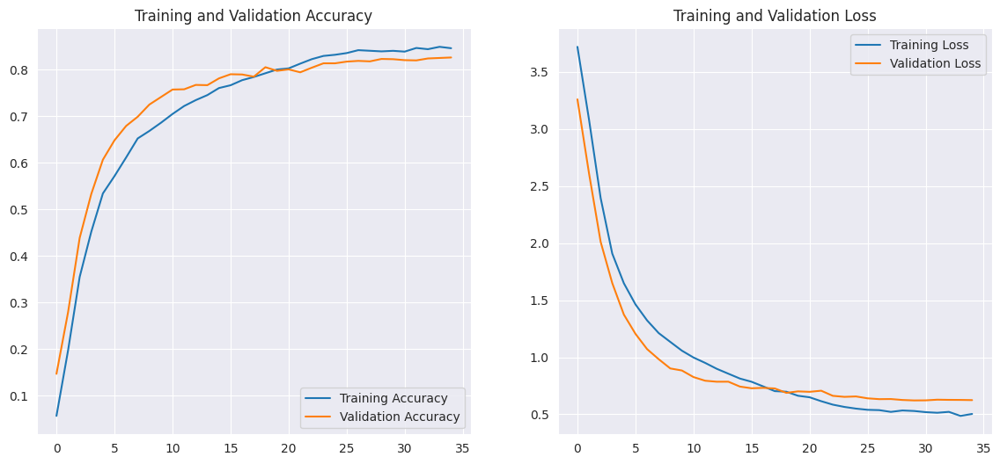

In [ ]:
def plot_history(history):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs_range = range(len(acc))

    plt.figure(figsize=(14,6))

    # Plot Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    # Plot Loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')

    plt.show()

# Panggil fungsi
plot_history(history)

Berdasarkan evaluasi yang telah dilakukan, didapatkan hasil bahwa model tidak mengalami overfitting. Hal ini ditunjukkan oleh nilai akurasi dan loss pada data training dan validasi yang relatif berdekatan serta mengikuti tren yang serupa sepanjang proses pelatihan. Tidak terdapat lonjakan signifikan pada validation loss maupun penurunan pada validation accuracy, yang mengindikasikan bahwa model mampu belajar secara efektif tanpa kehilangan kemampuan generalisasi terhadap data baru.

Selanjutnya, kami melakukan evaluasi model pada data uji dengan memprediksi label menggunakan model yang telah dilatih. Hasil prediksi kemudian dibandingkan dengan label asli untuk menghasilkan laporan klasifikasi yang mendetail serta matriks kebingungan (confusion matrix) yang divisualisasikan dalam bentuk heatmap guna melihat performa model secara keseluruhan pada setiap kelas.

75/75 ━━━━━━━━━━━━━━━━━━━━ 6s 41ms/step
                           precision    recall  f1-score   support

              Ayam Crispy       0.82      0.82      0.82        68
               Ayam Kecap       0.79      0.78      0.78        63
           Ayam Serundeng       0.76      0.94      0.84        54
                    Bakso       0.84      0.90      0.87        52
               Bubur Ayam       0.80      0.72      0.76        61
                   Capcay       0.73      0.82      0.77        50
               Cumi Bakar       0.83      0.71      0.77        63
               Cumi Hitam       0.85      0.92      0.89        63
                Cumi Rica       0.77      0.60      0.67        62
                Gado-Gado       0.72      0.82      0.77        66
              Garang Asem       0.80      0.80      0.80        51
                    Gudeg       0.79      0.70      0.75        54
               Ikan Bakar       0.76      0.81      0.79        75
              Ikan Go

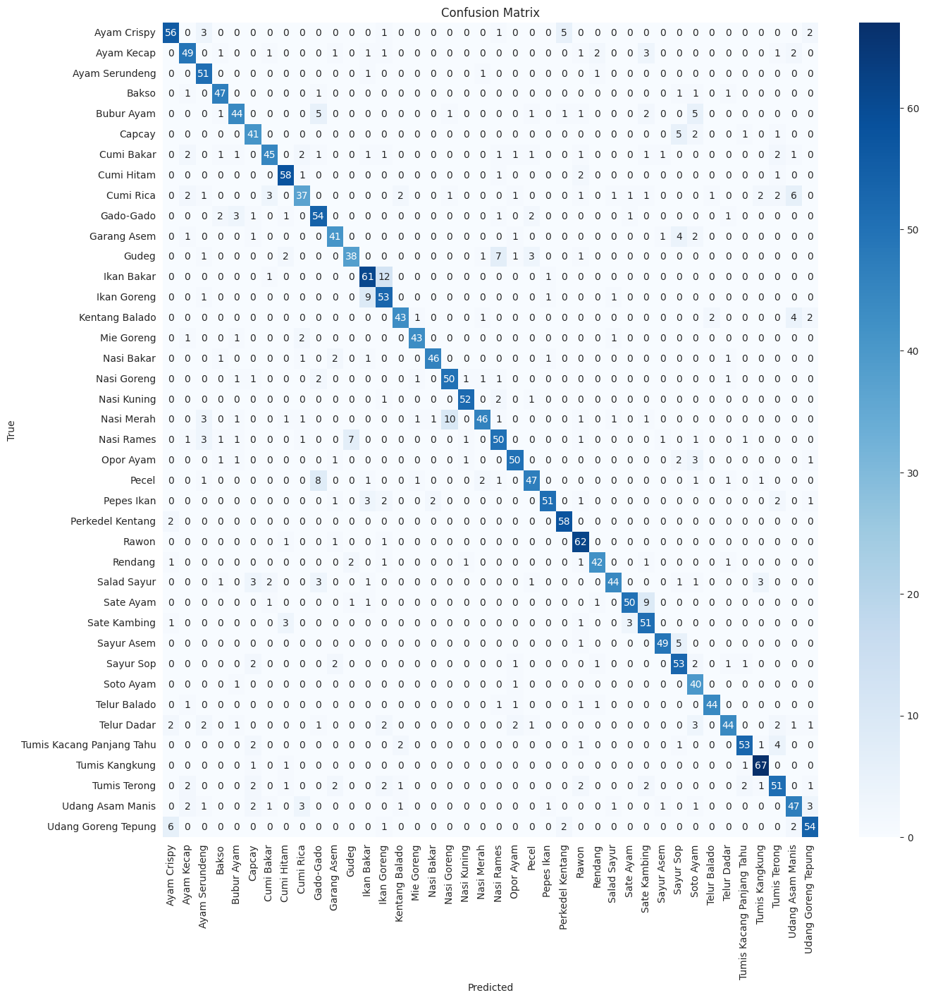

In [ ]:
# Prediksi label test set
test_generator.reset()
pred_prob = model.predict(test_generator, verbose=1)
y_pred = np.argmax(pred_prob, axis=1)
y_true = test_generator.classes

# Nama kelas
class_names = list(test_generator.class_indices.keys())

# Classification report
print(classification_report(y_true, y_pred, target_names=class_names))

# Confusion matrix
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(15, 15))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# **Konversi Model**

Selanjutnya kami akan menyimpan model yang telah dilatih dengan membuat struktur direktori penyimpanan yang rapi dan terorganisir. Folder `SavedModel` digunakan untuk menyimpan model dalam format TensorFlow SavedModel, sementara folder `tfjs_model` disiapkan untuk model yang dikonversi ke format TensorFlow\.js.

In [ ]:
# Buat struktur direktori penyimpanan
base_dir = "capstone"
os.makedirs(f"{base_dir}/SavedModel", exist_ok=True)
os.makedirs(f"{base_dir}/tfjs_model", exist_ok=True)

**SavedModel**

Selanjutnya, kami menyimpan model yang telah dilatih ke dalam format TensorFlow SavedModel menggunakan fungsi `tf.saved_model.save`. Model disimpan pada direktori yang sudah disiapkan sebelumnya, dan proses ini memastikan model dapat digunakan kembali untuk inferensi atau pengembangan lebih lanjut.

In [ ]:
saved_model_path = os.path.join(base_dir, "SavedModel")
tf.saved_model.save(model, saved_model_path)
print("SavedModel berhasil disimpan.")

SavedModel berhasil disimpan.


**TFJS**

Selanjutnya, kami melakukan konversi model yang sudah disimpan ke format TensorFlow\.js menggunakan library `tensorflowjs`. Konversi ini bertujuan agar model dapat dijalankan langsung di lingkungan web browser, memudahkan integrasi dan penggunaan model pada aplikasi web.

In [ ]:
import tensorflowjs as tfjs

# --- Konversi ke TensorFlow.js ---
tfjs_output_path = os.path.join(base_dir, "tfjs_model")
tfjs.converters.convert_tf_saved_model(saved_model_path, tfjs_output_path)
print("Model berhasil dikonversi ke TensorFlow.js.")

Model berhasil dikonversi ke TensorFlow.js.


**ZIP Kompress**

Selanjutnya, kami mengompres folder yang berisi model dalam berbagai format menjadi file .zip untuk memudahkan proses pengunduhan dan penyimpanan. Dengan langkah ini, semua file model bisa diunduh sekaligus dari Google Colab dalam satu paket bernama model.zip.

In [ ]:
from google.colab import files

# --- Kompres Folder Menjadi .zip dan Unduh ---
zip_file = shutil.make_archive("model", 'zip', base_dir)
files.download(zip_file)
print("Semua format model dikemas dalam file 'model.zip'.")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Semua format model dikemas dalam file 'model.zip'.


# **Inference**

Selanjutnya, kami melakukan inferensi pada 10 gambar pertama dari kelas "Telur Balado" menggunakan model yang telah disimpan dalam format SavedModel. Proses ini meliputi pemuatan model dan label kelas, preprocessing gambar agar sesuai input model, serta prediksi kelas dengan menampilkan label dan probabilitas prediksi secara visual dalam sebuah grid gambar. Hasil inferensi juga disimpan dalam file gambar `hasil_inference.png` untuk dokumentasi lebih lanjut.


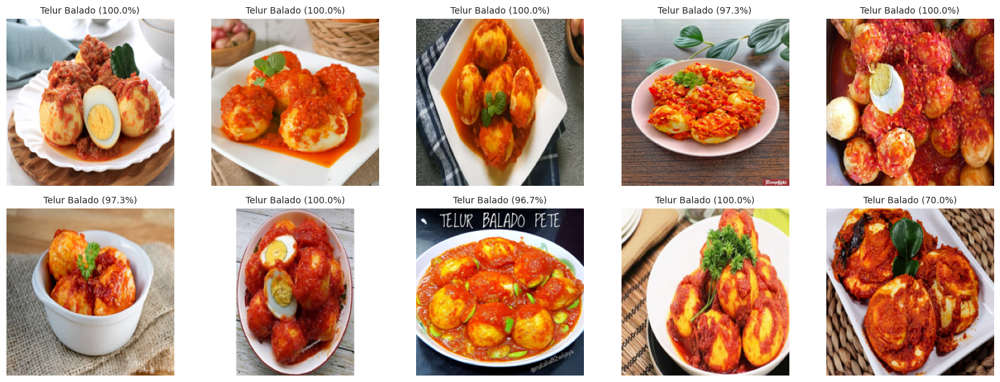

In [ ]:
# === Konfigurasi path ===
folder_gambar = "NutriScoreDataset/Telur Balado"
saved_model_path = "capstone/SavedModel"
label_file = "labels.txt"

# === Muat label kelas ===
with open(label_file, "r") as file:
    labels = [line.strip() for line in file.readlines()]

# === Muat model SavedModel ===
model = tf.saved_model.load(saved_model_path)
infer = model.signatures['serving_default']

# === Ambil 10 gambar pertama dari folder ===
allowed_ext = ['.jpg', '.jpeg', '.png']
gambar_terpilih = sorted([
    fname for fname in os.listdir(folder_gambar)
    if any(fname.endswith(ext) for ext in allowed_ext)
])[:10]

# === Siapkan canvas untuk menampilkan hasil ===
fig, axes = plt.subplots(2, 5, figsize=(16, 6))
axes = axes.ravel()

for i, nama_file in enumerate(gambar_terpilih):
    path_gambar = os.path.join(folder_gambar, nama_file)
    gambar = Image.open(path_gambar).resize((224, 224))
    img_array = np.asarray(gambar, dtype=np.float32) / 255.0

    # Pastikan gambar 3 channel (RGB)
    if img_array.ndim == 2:
        img_array = np.stack([img_array] * 3, axis=-1)
    elif img_array.shape[-1] != 3:
        img_array = np.repeat(img_array, 3, axis=-1)

    # Tambahkan batch dimensi
    img_input = np.expand_dims(img_array, axis=0)

    # === Lakukan inferensi ===
    output = infer(tf.convert_to_tensor(img_input))

    # Ambil hasil prediksi
    pred_index = np.argmax(output['output_0'].numpy())
    pred_label = labels[pred_index]
    pred_prob = output['output_0'].numpy()[0, pred_index] * 100

    # Tampilkan hasil
    axes[i].imshow(gambar)
    axes[i].set_title(f"{pred_label} ({pred_prob:.1f}%)", fontsize=10)
    axes[i].axis('off')

# Kosongkan slot sisa jika gambar kurang dari 10
for k in range(len(gambar_terpilih), len(axes)):
    axes[k].axis('off')

plt.tight_layout()
plt.savefig("hasil_inference.png")
plt.show()

Berdasarkan hasil inference yang ditampilkan pada gambar, model berhasil mengklasifikasikan seluruh gambar makanan sebagai "Telur Balado" dengan tingkat kepercayaan (confidence) yang sangat tinggi, berkisar antara 70.0% hingga 100.0%. Mayoritas gambar menunjukkan confidence di atas 95%, yang mengindikasikan bahwa model memiliki kemampuan identifikasi visual yang sangat baik dan konsisten terhadap kelas tersebut. Meskipun ada satu gambar dengan confidence yang lebih rendah (70.0%), hal ini masih tergolong dapat diterima dan menunjukkan bahwa model cukup toleran terhadap variasi tampilan visual dari objek yang sama. Secara keseluruhan, hasil ini menunjukkan bahwa model mampu melakukan klasifikasi dengan akurasi tinggi terhadap objek yang dikenali.